# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [37]:
#%%capture
#!git clone https://github.com/oballinger/mining-detector
#import os
#os.chdir('mining-detector/notebooks')
#!pip install descarteslabs clearml
#!gsutil cp gs://qm2/training_data.zip '../data/training_data.zip'
#!unzip -o '../data/training_data.zip' -d '../'

In [38]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [39]:
from datetime import date
import os
import pickle
import sys

import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras import layers
from keras.layers import Input, Concatenate
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools

## Open Data

In [47]:
resolution = 48



data_file_names = [
                    'bolivar_2020_thresh_0.8_1_negatives',
                    'amazonas_2020_thresh_0.5_2_negatives',
                    'riverbank_negatives',
                    'amazonas_2020_thresh_0.8_sumbsample_3_positives',
                    'MinesPos2018-2020Sentinel_points',
                    #'bolivar_2020_thresh_0.8_sumbsample_5_positives',
                    'full_amazon_v9_negatives',
                    'v2.0_bolivar_negatives',
                    'v2.1.1_bolivar_negatives',
                    'v2.4_amazonas_negatives',
                    'v2.4_amazon_negatives',
                    'v2.4_amazon_positives',
                    'v2.6_amazon_thresh_0.8_negatives',
                    'v2.6_amazon_negatives',
                    'v2.6_amazon_negatives_v2'
              ]

data_file_names = [
                    'myanmar_positives', 
                    'myanmar_negatives',
                    #'riverbank_negatives',
              ]



start_dates = ['2022-01-01', '2022-03-01', '2022-11-01']
end_dates=['2022-03-01', '2022-05-01', '2023-01-01']

#start_dates = ['2022-01-01']
#end_dates = ['2023-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]

"""
data_files += [
    #'v3.1_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl', 
    'amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_arrays.pkl', 
    'v3.2_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
    'v3.3_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl',
    'v3.4_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
    'v3.5_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
    'v3.6_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl'
    ]
label_files += [
    #'v3.1_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl', 
    'amazon_all_48px_v3.1_2023_positives_0.999_2023-01-01_2024-01-01_patch_array_labels.pkl', 
    'v3.2_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
    'v3.3_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl',
    'v3.4_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
    'v3.5_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
    'v3.6_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl'
    ]
"""
patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/6 [00:00<?, ?it/s]

5913 samples loaded
1344 positive samples
4569 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

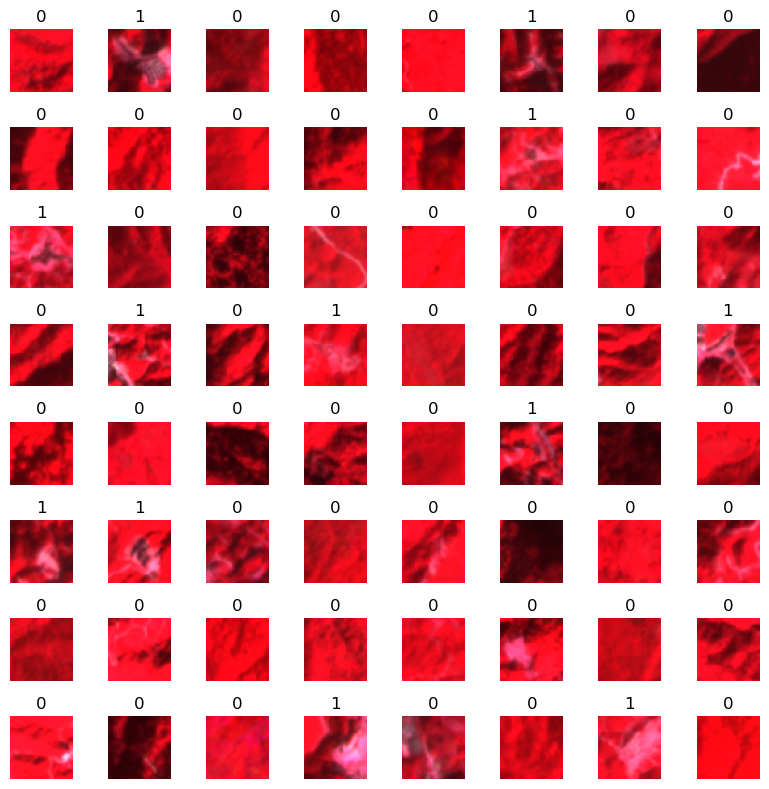

In [48]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [49]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


100.0% of data below brightness limit


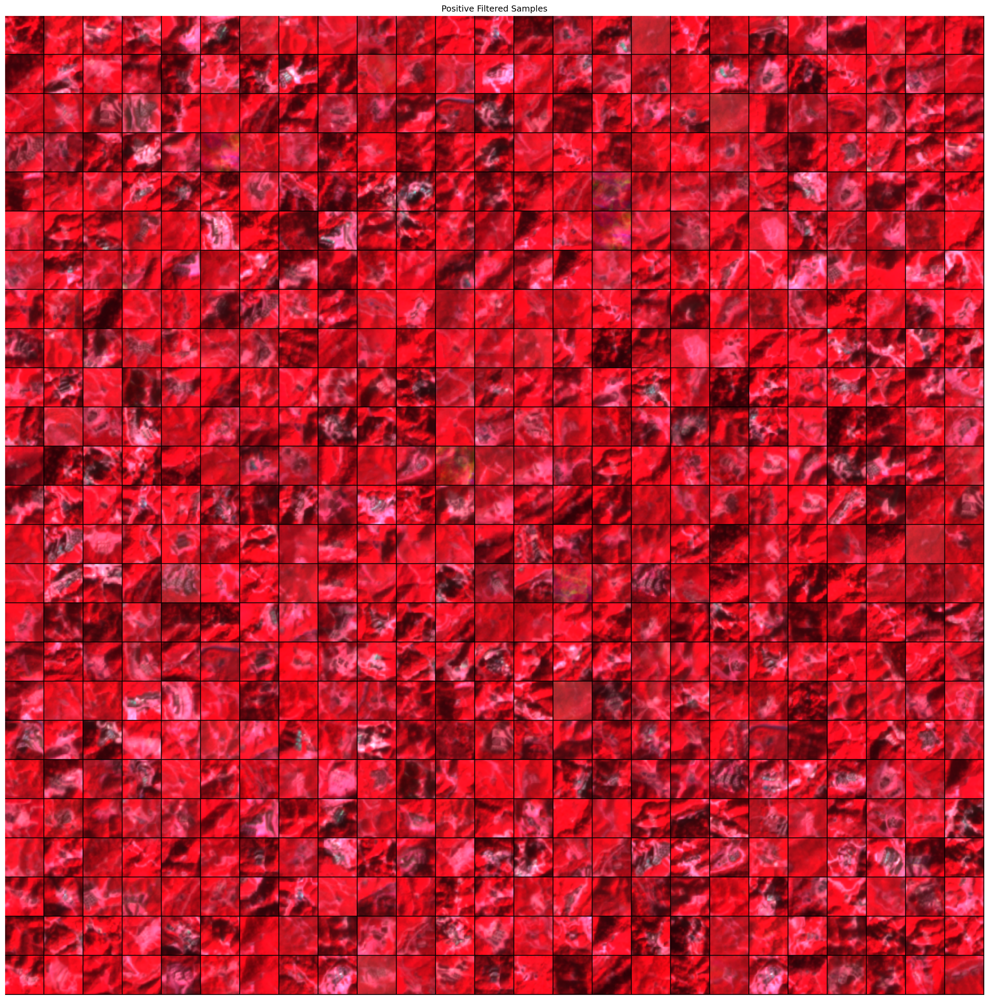

In [50]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


100.0% of data below brightness limit


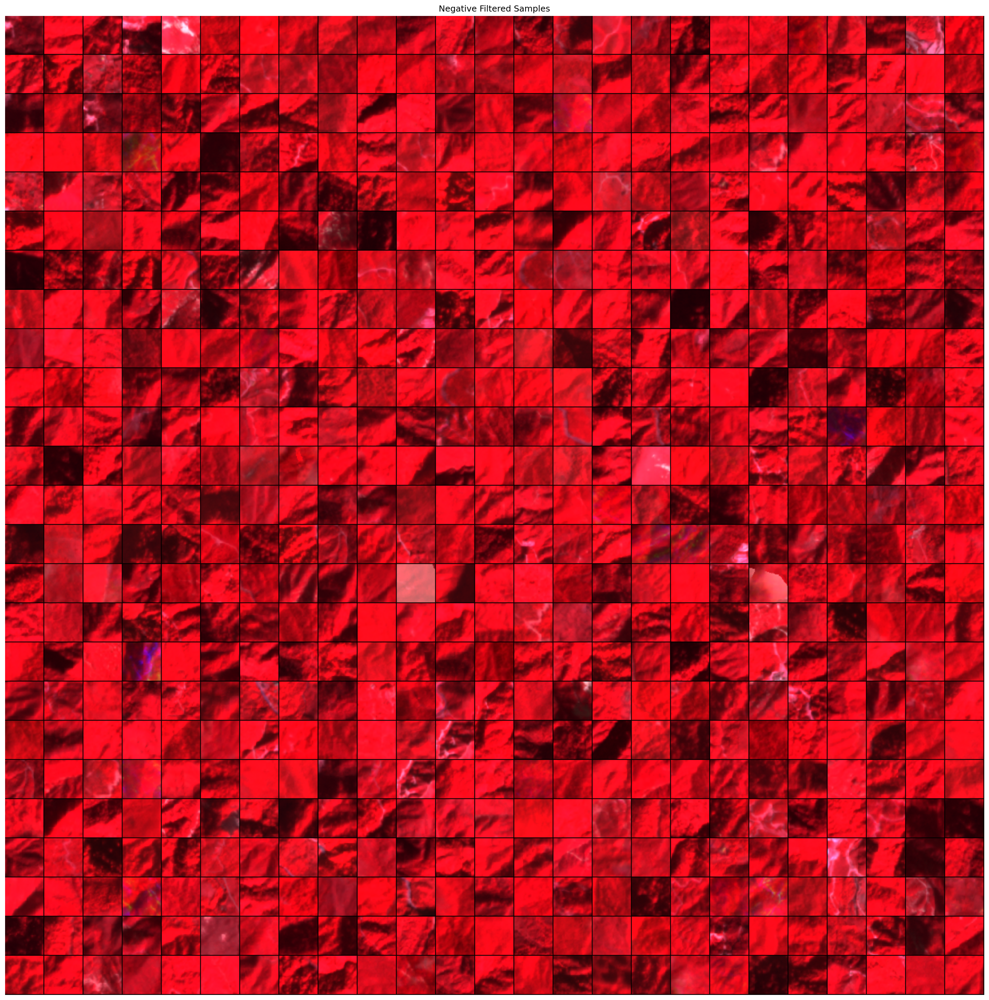

In [51]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**24
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [53]:
#x = normalize(np.copy(images[:,:,:,[0,1,2,3]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

In [54]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


AttributeError: 'NumpyArrayIterator' object has no attribute 'next'

<Figure size 1800x1800 with 0 Axes>

In [55]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

## Train Ensemble

In [43]:
!wandb disabled
%env CLEARML_WEB_HOST=https://app.clear.ml
%env CLEARML_API_HOST=https://api.clear.ml
%env CLEARML_FILES_HOST=https://files.clear.ml
%env CLEARML_API_ACCESS_KEY=2Q4A63VXFVDJKTWW3V6K
%env CLEARML_API_SECRET_KEY=L86EAC2y0GKl14Kkj5mY8YKNt34kA2NRygLMOyEFWOxCzIiZGm


W&B disabled.
env: CLEARML_WEB_HOST=https://app.clear.ml
env: CLEARML_API_HOST=https://api.clear.ml
env: CLEARML_FILES_HOST=https://files.clear.ml
env: CLEARML_API_ACCESS_KEY=2Q4A63VXFVDJKTWW3V6K
env: CLEARML_API_SECRET_KEY=L86EAC2y0GKl14Kkj5mY8YKNt34kA2NRygLMOyEFWOxCzIiZGm


ModuleNotFoundError: No module named 'clearml'

In [46]:
version_number = f"4.0"
batch_size = 32    
epochs = 160
iterations= 3

step_time=38
num_steps=137
train_time=((num_steps*(step_time/1000))*epochs*iterations)/60
print("Estimated training time: ", int(train_time), "minutes")

Estimated training time:  41 minutes


In [57]:
import wandb
version_number = f"4.0"
batch_size = 32    
epochs = 160
iterations= 2

step_time=19
train_time=((33*(step_time/1000))*epochs*iterations)/60
print("Estimated training time: ", int(train_time), "minutes")



models = []

for seed in range(0,iterations):
    keras.utils.set_random_seed(seed)
    x_train, x_test, y_train, y_test = train_test_split(
        x_norm, y, test_size=0.30, random_state=seed
    )

    num_classes = 2
    input_shape = x_train.shape[1:]

    model = keras.Sequential(
        [
            keras.Input(shape=input_shape),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.MaxPooling2D(pool_size=(2)),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.MaxPooling2D(pool_size=(2)),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.Conv2D(32, kernel_size=(3), padding="same", activation="relu"),
            layers.MaxPooling2D(pool_size=(3)),
            layers.Flatten(),
            layers.Dense(64, activation="relu"),
            layers.Dropout(0.3),
            layers.Dense(64, activation="relu"),
            layers.Dropout(0.3),
            layers.Dense(32, activation="relu"),
            layers.Dropout(0.3),
            layers.Dense(1, activation="sigmoid"),
        ]
    )
    model.compile(
        optimizer=keras.optimizers.Adam(3e-4),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(name="acc")],
    )

    train_accuracy = []
    test_accuracy = []
    train_loss = []
    test_loss = []


    # add a weighted loss
    class_weight = {0: 1, 1: 1}

    model.fit(
        datagen.flow(x_train, y_train),
        batch_size=batch_size,
        epochs=epochs,
        validation_data=(x_test, y_test),
        verbose=1,
        shuffle=True,
        class_weight=class_weight,
    )

    models.append(model)

# combine all models into one ensemble model
input_layer = Input(shape=models[0].input_shape[1:]) # c - channels
model_outputs = []
for model in models: # Assuming you have a list of your Keras models
    model_output = model(input_layer)
    model_outputs.append(model_output)

concatenated_output = Concatenate()(model_outputs)
ensemble_model = Model(input_layer, concatenated_output)

# compile the model so it doesn't get annoying later
ensemble_model.compile(
    optimizer=keras.optimizers.Adam(3e-4),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)
ensemble_model.summary()
current_date = date.today()
model_name = f"{resolution}px_v{version_number}_ensemble_{current_date.isoformat()}"

assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"
model.save(f"../models/{model_name}.h5")



Estimated training time:  3 minutes
Epoch 1/160


/Users/ollieballinger/miniconda3/envs/geo/lib/python3.9/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


130/130 ━━━━━━━━━━━━━━━━━━━━ 14s 81ms/step - acc: 0.7532 - loss: 0.5458 - val_acc: 0.8844 - val_loss: 0.2845
Epoch 2/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 54ms/step - acc: 0.8973 - loss: 0.2596 - val_acc: 0.8946 - val_loss: 0.2446
Epoch 3/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 55ms/step - acc: 0.8895 - loss: 0.2634 - val_acc: 0.8957 - val_loss: 0.2500
Epoch 4/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 55ms/step - acc: 0.9059 - loss: 0.2344 - val_acc: 0.9121 - val_loss: 0.2188
Epoch 5/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - acc: 0.9025 - loss: 0.2450 - val_acc: 0.9109 - val_loss: 0.2088
Epoch 6/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - acc: 0.9138 - loss: 0.2261 - val_acc: 0.9132 - val_loss: 0.2031
Epoch 7/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 8s 58ms/step - acc: 0.9091 - loss: 0.2117 - val_acc: 0.9194 - val_loss: 0.1895
Epoch 8/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 92s 710ms/step - acc: 0.9227 - loss: 0.1923 - val_acc: 0.9239 - val_loss: 0.1838
Epoch 9/160
130/130 ━━━━━━━━━━━━━━━━━━━━ 32s 250m

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7       │ (None, 48, 48, 4) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_5        │ (None, 1)         │    114,273 │ input_layer_7[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_6        │ (None, 1)         │    114,273 │ input_layer_7[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 2)         │          0 │ sequential_5[0][… │
│ (Concatenate)       │                   │            │ sequential_6[0][… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 228,546 (892.76 KB)

 Trainable params: 228,546 (892.76 KB)

 Non-trainable params: 0 (0.00 B)

# Evaluate Model Performance Characteristics

Find the threshold that maximizes performance on the test set. Note that while this may be the optimum performance on the test set, it does not account for the fact that false positives are functionally worse than false negatives.

56/56 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step


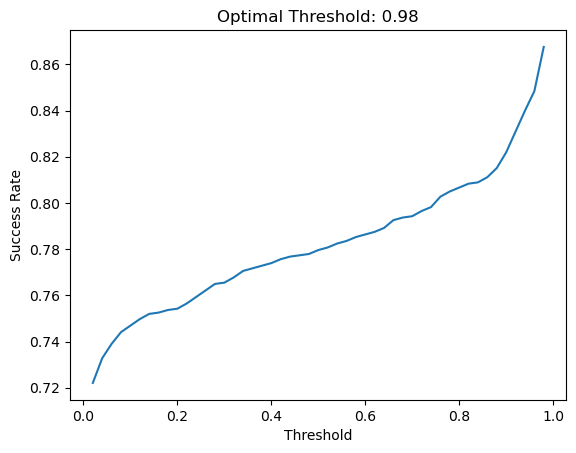

In [58]:
test_model = model

val_images = x_test
val_labels = y_test

test_preds = test_model.predict(val_images)
thresh = []
score = []
for threshold in range(2, 100, 2):
    threshold /= 100
    thresh.append(threshold)
    test_labels = [np.argmax(y) for y in val_labels]
    test_out = [pred > threshold for pred in test_preds]
    score.append(1 - (np.sum(np.array(test_labels) != np.array(test_out)[:,0]) / len(test_labels)))
    #print(np.sum(np.array(test_labels) != np.array(test_preds)), "of", len(test_labels), "test set predictions incorrect")
plt.plot(thresh, score)
plt.ylabel('Success Rate')
plt.xlabel('Threshold')
plt.title(f"Optimal Threshold: {thresh[np.argmax(score)]:.2f}")
plt.show()
optimal_threshold = thresh[np.argmax(score)]

Plot images that the model classifies incorrectly. Can be useful to evaluate model bias.

In [ ]:
threshold = 0.8
test_model = model
val_images = x_test
val_labels = y_test
test_labels = val_labels
test_preds = test_model.predict(val_images)
for index, (label, pred, img) in enumerate(zip(test_labels, test_preds, val_images)):
    pred = pred[0]
    if pred < threshold:
        binary_pred = 0
    else:
        binary_pred = 1
    if label != binary_pred:
        rgb = (img[:,:,3:0:-1] * 10000 / 3000)
        fig = plt.figure(figsize=(2,2), facecolor=(1,1,1), dpi=150)
        plt.imshow(np.clip(rgb, 0, 1))
        plt.title(f"label: {label} - pred: {pred:.2f}")
        plt.axis('off')
        plt.show()